In [1]:
from __future__ import division, print_function, absolute_import

# Import MNIST data
from tensorflow.examples.tutorials.mnist import input_data
mnist = input_data.read_data_sets("data/", one_hot=False)

import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
from keras.datasets import mnist as mn
from keras.preprocessing.image import ImageDataGenerator
from matplotlib import pyplot
from keras import backend as K
K.set_image_dim_ordering('th')

/anaconda3/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


Instructions for updating:
Please use alternatives such as official/mnist/dataset.py from tensorflow/models.
Instructions for updating:
Please write your own downloading logic.
Instructions for updating:
Please use tf.data to implement this functionality.
Extracting data/train-images-idx3-ubyte.gz
Instructions for updating:
Please use tf.data to implement this functionality.
Extracting data/train-labels-idx1-ubyte.gz
Extracting data/t10k-images-idx3-ubyte.gz
Extracting data/t10k-labels-idx1-ubyte.gz
Instructions for updating:
Please use alternatives such as official/mnist/dataset.py from tensorflow/models.


Using TensorFlow backend.


In [2]:
# Training Parameters
learning_rate = 0.01
num_steps = 500
batch_size = 128
n_images = 10000

# Network Parameters
num_input = 784 # MNIST data input (img shape: 28*28)
num_classes = 10 # MNIST total classes (0-9 digits)
dropout = 0.25 # Dropout, probability to drop a unit

In [3]:
# Create the neural network
def conv_net(x_dict, n_classes, dropout, reuse, is_training):
    
    # Define a scope for reusing the variables
    with tf.variable_scope('ConvNet', reuse=reuse):
        # TF Estimator input is a dict, in case of multiple inputs
        x = x_dict['images']

        # MNIST data input is a 1-D vector of 784 features (28*28 pixels)
        # Reshape to match picture format [Height x Width x Channel]
        # Tensor input become 4-D: [Batch Size, Height, Width, Channel]
        x = tf.reshape(x, shape=[-1, 28, 28, 1])

        # Convolution Layer with 32 filters 
        conv1 = tf.layers.conv2d(x, 32, 5, activation=tf.nn.relu)

        # Convolution Layer with 64 filters 
        conv2 = tf.layers.conv2d(conv1, 64, 3, activation=tf.nn.relu)

        # Flatten the data to a 1-D vector for the fully connected layer
        fc1 = tf.contrib.layers.flatten(conv2)

        # Fully connected layer (in tf contrib folder for now)
        fc1 = tf.layers.dense(fc1, 1024)
        # Apply Dropout (if is_training is False, dropout is not applied)
        fc1 = tf.layers.dropout(fc1, rate=dropout, training=is_training)

        # Output layer, class prediction
        out = tf.layers.dense(fc1, n_classes)

    return out


In [4]:
# Define the model function (following TF Estimator Template)
def model_fn(features, labels, mode):
    
    # Build the neural network
    # Because Dropout have different behavior at training and prediction time, we
    # need to create 2 distinct computation graphs that still share the same weights.
    logits_train = conv_net(features, num_classes, dropout, reuse=False, is_training=True)
    logits_test = conv_net(features, num_classes, dropout, reuse=True, is_training=False)
    
    # Predictions
    pred_classes = tf.argmax(logits_test, axis=1)
    pred_probas = tf.nn.softmax(logits_test)
    
    # If prediction mode, early return
    if mode == tf.estimator.ModeKeys.PREDICT:
        return tf.estimator.EstimatorSpec(mode, predictions=pred_classes) 
        
    # Define loss and optimizer
    loss_op = tf.reduce_mean(tf.nn.sparse_softmax_cross_entropy_with_logits(
        logits=logits_train, labels=tf.cast(labels, dtype=tf.int32)))
    optimizer = tf.train.AdamOptimizer(learning_rate=learning_rate)
    train_op = optimizer.minimize(loss_op, global_step=tf.train.get_global_step())
    
    # Evaluate the accuracy of the model
    acc_op = tf.metrics.accuracy(labels=labels, predictions=pred_classes)
    
    # TF Estimators requires to return a EstimatorSpec, that specify
    # the different ops for training, evaluating, ...
    estim_specs = tf.estimator.EstimatorSpec(
      mode=mode,
      predictions=pred_classes,
      loss=loss_op,
      train_op=train_op,
      eval_metric_ops={'accuracy': acc_op})

    return estim_specs

In [5]:
# Build the Estimator
model = tf.estimator.Estimator(model_fn)

INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': '/var/folders/33/cbwqx9c11lgfbcvwxr2yf6jm0000gn/T/tmpacuncz1h', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': None, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x1c3ef6d940>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}


In [6]:
# Define the input function for training
X_tr={'images': mnist.train.images}
Y_tr=mnist.train.labels
input_fn = tf.estimator.inputs.numpy_input_fn(
    x=X_tr, y=Y_tr,
    batch_size=batch_size, num_epochs=None, shuffle=True)
# Train the Model
model.train(input_fn, steps=num_steps)

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Create CheckpointSaverHook.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Saving checkpoints for 0 into /var/folders/33/cbwqx9c11lgfbcvwxr2yf6jm0000gn/T/tmpacuncz1h/model.ckpt.
INFO:tensorflow:loss = 2.2863493, step = 1
INFO:tensorflow:global_step/sec: 2.10162
INFO:tensorflow:loss = 0.28879204, step = 101 (47.583 sec)
INFO:tensorflow:global_step/sec: 2.10528
INFO:tensorflow:loss = 0.31116956, step = 201 (47.500 sec)
INFO:tensorflow:global_step/sec: 2.15699
INFO:tensorflow:loss = 0.061168537, step = 301 (46.361 sec)
INFO:tensorflow:global_step/sec: 2.19452
INFO:tensorflow:loss = 0.17248681, step = 401 (45.568 sec)
INFO:tensorflow:Saving checkpoints for 500 into /var/folders/33/cbwqx9c11lgfbcvwxr2yf6jm0000gn/T/tmpacuncz1h/model.ckpt.
INFO:tensorflow:Loss for final step: 0.076312736.


In [7]:
# Evaluate the Model
# Define the input function for evaluating
input_fn = tf.estimator.inputs.numpy_input_fn(
    x={'images': mnist.test.images}, y=mnist.test.labels,
    batch_size=batch_size, shuffle=False)
# Use the Estimator 'evaluate' method
model.evaluate(input_fn)

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-10-21-19:26:36
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /var/folders/33/cbwqx9c11lgfbcvwxr2yf6jm0000gn/T/tmpacuncz1h/model.ckpt-500
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-10-21-19:26:44
INFO:tensorflow:Saving dict for global step 500: accuracy = 0.9685, global_step = 500, loss = 0.11082116
INFO:tensorflow:Saving 'checkpoint_path' summary for global step 500: /var/folders/33/cbwqx9c11lgfbcvwxr2yf6jm0000gn/T/tmpacuncz1h/model.ckpt-500


{'accuracy': 0.9685, 'loss': 0.11082116, 'global_step': 500}

In [26]:
write = 1
if write==1:
    f = open("shade.txt", 'w')

# Predict single images
# Get images from test set
test_images = mnist.test.images[:n_images]
test_label=mnist.test.labels[:n_images]

# # reshape to be [samples][pixels][width][height]
X_test = test_images
y_test = test_label
X_test = X_test.reshape(X_test.shape[0], 1, 28, 28)
# # convert from int to float
X_test = X_test.astype('float32')

X_test_backup = X_test
Y_test_backup = y_test

yBackup = []
pBackup = []

In [9]:
mValue = 0.0001
Xnew = [[[[v-mValue if v-mValue>0.0 else 0.0 for v in n] for n in x[0]]] for x in X_test]
X_test = np.array(Xnew)
# print(len(X_test[0]))
# for x in X_test[0]:
#     for y in x:
#         print(y)
X_test.shape
print("================")

In [10]:
print(X_test.shape)

(10000, 1, 28, 28)


In [32]:
for x in Xnew:
    for y in x:
        print(y)

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.1097039299249649, 0.8508804606437683, 0.9920569228172302, 0.9802922176361084, 0.21166472306251527, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.49793924560546876, 0.9920569228172302, 0.9920569228172302, 0.5999000238418579, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.207743154668808, 0.9646059440612793, 0.9920569228172302, 0.7646059559822083, 0.035194119268655774, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.529311792755127, 0.9959784912109375, 0.7842137979507446, 0.07048823853731155, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.3920568989753723, 0.9959784912109375, 0.9449981020927429, 0.11754706671237945, 0.0, 0.0, 0.0, 0

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.015586275437474251, 0.8822530077934265, 0.3763706254005432, 0.0, 0.0, 0.007743137718737125, 0.2665666805744171, 0.760684387588501, 0.8783314393997192, 0.4312725829124451, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.1920568810939789, 0.8979392813682556, 0.0783313753247261, 0.1097039299249649, 0.23519413342475892, 0.5920568870544434, 0.9999, 0.9763706492424011, 0.27833138575553895, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.1606843190431595, 0.9763706492424011, 0.8077432083129883, 0.9920569228172302, 0.8665667342185974, 0.8077432083129883, 0.9646059440612793, 0.7920569347381592, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.415586309337616, 0.7685275243759155, 0.48225297203063966, 0.062645101749897, 0.529311792755127, 0.9646059440612793, 0.5567627715110779, 0.0, 0.0, 0.0, 0.0, 

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.3685274588108063, 0.9920569228172302, 0.8116647767066956, 0.035194119268655774, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0940176563501358, 0.803821639919281, 0.9920569228172302, 0.9763706492424011, 0.37244902720451356, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.7724490927696228, 0.9920569228172302, 0.3175470696926117, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.6391157077789307, 0.9920569228172302, 0.9920569228172302, 0.6822529601097107, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.035194119268655774, 0.8195079134941101, 0.7057823704719544, 0.003821568859368563, 0.0, 0.0, 0.0, 0.0, 0.0, 0.47048826684951783, 0.988135354423523, 0.9920569228172302, 0.7057823704719544, 0.015586275437474251, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.1920568810939789, 0.9920569228172302, 0.5175470875740051, 0.0, 0.0, 0.0, 0.027350982481241227, 0.15284118225574495, 0.48225297203063966, 0.9410765336990357,

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.5449980663299561, 0.9920569228172302, 0.874409871006012, 0.058723533356189725, 0.0, 0.0, 0.0, 0.0, 0.49793924560546876, 0.9842137860298157, 0.4430372880935669, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.6195078658103943, 0.9920569228172302, 0.4744098352432251, 0.0, 0.0, 0.0, 0.0, 0.0783313753247261, 0.803821639919281, 0.9842137860298157, 0.3685274588108063, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0940176563501358, 0.760684387588501, 0.9999, 0.24695883860588075, 0.0, 0.0, 0.0, 0.14107647707462312, 0.45088042488098146, 0.9920569228172302, 0.8979392813682556, 0.23127256503105165, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.062645101749897, 0.7097039388656616, 0.9920569228172302, 0.321468638086319, 0.0, 0.0783313753247261, 0.0783313753247261, 0.8391157554626465, 0.9842137860298157, 0.9214686917304993, 0.25872354378700

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.3999000357627869, 0.9959784912109375, 0.9920569228172302, 0.321468638086319, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.321468638086319, 0.874409871006012, 0.9920569228172302, 0.6704882549285889, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.2822529541492462, 0.9920569228172302, 0.7959785031318665, 0.15676275064945222, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.7567628191947937, 0.988135354423523, 0.6391157077789307, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.48225297203063966, 0.9567628072738648, 0.9528412388801575, 0.1606843190431595, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.34499804844856263, 0.6391157077789307, 0.7646059559822083, 0.18421372940540315, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.19597844948768617, 0.6940176652908325, 0.9253902601242066, 0.988135354423523, 0.9920569228172302, 0.9920569228172302, 0.5332333611488342, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0312725508749485, 0.501860813999176, 0.960684375667572, 0.9920569228172302, 0.9959784912109375, 0.9410765336990357, 0.9920569228172302, 0.9920569228172302, 0.4626451300621033, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.40382160415649415, 0.8273510502815247, 0.9920569228172302, 0.960684375667572, 0.6626451181411743, 0.21166472306251527, 0.3057823645114899, 0.9920569228172302, 0.9920569228172302, 0.6077431606292725, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.7057823704719544, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.8861745761871338, 0.7489196228027344, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.960684375667572, 0.1763705926179886, 0.8548020290374756, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.8900961445808411, 0.22735099663734437, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.6038215922355652, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9842137860298157, 0.8783314393997192, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.6626451181411743, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.06656667014360428, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.992056922

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.250880406999588, 0.501860813999176, 0.9999, 0.9999, 0.9999, 0.501860813999176, 0.250880406999588, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.501860813999176, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.250880406999588, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.7489196228027344, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.7489196228027344, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.501860813999176, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.7489196228027344, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.250880406999588, 0.9999, 0.9

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.050880396568775174, 0.9920569228172302, 0.9371549653053284, 0.17244902422428132, 0.0, 0.0783313753247261, 0.3528411852359772, 0.42342944612503053, 0.9253902601242066, 0.9763706492424011, 0.9920569228172302, 0.6391157077789307, 0.3920568989753723, 0.011664707043766976, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.050880396568775174, 0.9920569228172302, 0.9920569228172302, 0.9646059440612793, 0.9489196704864502, 0.9567628072738648, 0.9842137860298157, 0.9802922176361084, 0.9920569228172302, 0.6391157077789307, 0.3920568989753723, 0.011664707043766976, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.003821568859368563, 0.058723533356189725, 0.7920569347381592, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.8979392813682556, 0.5057823823928833, 0.14891961386203767, 0.007743137718737125, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.10186079313755035, 0.8234294818878174, 0.988135354423523, 0.9920569228172302, 0.988135354423523, 0.988135354423523, 0.988135354423523, 0.6979392336845398, 0.035194119268655774, 0.03911568766236305, 0.501860813999176, 0.9920569228172302, 0.988135354423523, 0.658723549747467, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.47048826684951783, 0.9920569228172302, 0.9920569228172302, 0.9999, 0.9685275124549866, 0.8822530077934265, 0.4900961088180542, 0.0, 0.0, 0.0, 0.19990001788139344, 0.9999, 0.9920569228172302, 0.846958892250061, 0.062645101749897, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.37244902720451356, 0.8822530077934265, 0.988135354423523, 0.988135354423523, 0.9685275124549866, 0.6940176652908325, 0.0, 0.0, 0.0, 0.0, 0.0, 0.10186079313755035, 0.9920569228172302, 0.988135354423523, 0.8391157554626465, 0.058723533356189725, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.14891

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.06656667014360428, 0.9959784912109375, 0.9920569228172302, 0.9920569228172302, 0.960684375667572, 0.9057824181556702, 0.6391157077789307, 0.6077431606292725, 0.6744098233222962, 0.960684375667572, 0.9920569228172302, 0.9410765336990357, 0.45088042488098146, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.4116647409439087, 0.7528412508010864, 0.9920569228172302, 0.9920569228172302, 0.9959784912109375, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9959784912109375, 0.8430373238563538, 0.36068432202339173, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.050880396568775174, 0.43519415130615235, 0.6273510025978088, 0.7646059559822083, 0.960684375667572, 0.6940176652908325, 0.6273510025978088, 0.2704882489681244, 0.02342941408753395, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.36068432202339173, 0.9646059440612793, 0.9920569228172302, 0.846958892250061, 0.043037256056070325, 0.0, 0.0, 0.0, 0.4312725829124451, 0.9920569228172302, 0.9920569228172302, 0.24303727021217347, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.9999, 0.9920569228172302, 0.960684375667572, 0.3528411852359772, 0.0, 0.0, 0.0, 0.0, 0.3371549116611481, 0.9920569228172302, 0.9920569228172302, 0.019507843831181527, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.2587235437870026, 0.9018608497619629, 0.5175470875740051, 0.0, 0.0, 0.0, 0.0, 0.0, 0.003821568859368563, 0.2665666805744171, 0.5842137502670288, 0.011664707043766976, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.03911568766236305, 0.7018608020782471, 0.7999000715255737, 0.32931177487373353, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.14891961386203767, 0.48225297203063966, 0.988135354423523, 0.9920569228172302, 0.32931177487373353, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.6626451181411743, 0.988135354423523, 0.988135354423523, 0.760684387588501, 0.07440980693101883, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.10186079313755035, 0.9528412388801575, 0.988135354423523, 0.7920569347381592, 0.050880396568775174, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.15676275064945222, 0.37244902720451356, 0.9567628072738648, 0.9920569228172302, 0.874409871006012, 0.7842137979507446, 0.7842137979507446, 0.7842137979507446, 0.7842137979507446, 0.7842137979507446, 0.988135354423523, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.529311792755127, 0.015586275437474251, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.03911568766236305, 0.3802921937942505, 0.9293118285179138, 0.9920569228172302, 0.9920569228172302, 0.6273510025978088, 0.11362549831867218, 0.0, 0.0, 0.0, 0.0, 0.0, 0.24695883860588075, 0.2548019753932953, 0.5528412031173706, 0.7842137979507446, 0.9920569228172302, 0.9920569228172302, 0.415586309337616, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.027350982481241227, 0.6548019813537598, 0.9920569228172302, 0.9920569228172302, 0.7097039388656616, 0.5920568870544434, 0.11362549831867218, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0469588281750679, 0.3371

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.3528411852359772, 0.9959784912109375, 0.6038215922355652, 0.011664707043766976, 0.0, 0.011664707043766976, 0.7371549176216126, 0.5371549295425415, 0.0, 0.1097039299249649, 0.3959784673690796, 0.8626451658248901, 0.9842137860298157, 0.6195078658103943, 0.2900960909366608, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.2391157018184662, 0.9959784912109375, 0.8116647767066956, 0.035194119268655774, 0.0, 0.0, 0.31362550129890443, 0.6195078658103943, 0.8391157554626465, 0.9489196704864502, 0.9802922176361084, 0.49793924560546876, 0.08225294371843338, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.2391157018184662, 0.9959784912109375, 0.9959784912109375, 0.364605890417099, 0.3959784673690796, 0.8391157554626465, 0.9449981020927429, 0.9959784912109375, 0.9959784912109375, 0.6822529601097107, 0.29401765933036805, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.9920569228172302, 0.988135354423523, 0.7685275243759155, 0.035194119268655774, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.9920569228172302, 0.988135354423523, 0.658723549747467, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.3959784673690796, 0.9920569228172302, 0.988135354423523, 0.4626451300621033, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.6900960968971253, 0.9959784912109375, 0.9685275124549866, 0.19597844948768617, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.07440980693101883, 0.9057824181556702, 0.9920569228172302, 0.6704882549285889, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0,

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.003821568859368563, 0.027350982481241227, 0.364605890417099, 0.7528412508010864, 0.5136255191802979, 0.1449980454683304, 0.027350982481241227, 0.027350982481241227, 0.007743137718737125, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0783313753247261, 0.831272618675232, 0.9959784912109375, 0.9959784912109375, 0.9959784912109375, 0.9959784912109375, 0.9959784912109375, 0.9959784912109375, 0.615586297416687, 0.36068432202339173, 0.007743137718737125, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.07048823853731155, 0.6273510025978088, 0.9959784912109375, 0.9959784912109375, 0.99

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.5136255191802979, 0.9920569228172302, 0.7763706611633301, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.03911568766236305, 0.874409871006012, 0.9920569228172302, 0.45088042488098146, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.15676275064945222, 0.9920569228172302, 0.803821639919281, 0.02342941408753395, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.48617454042434693, 0.9959784912109375, 0.686174528503418, 0.17244902422428132, 0.5606843399047852, 0.32931177487373353, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.03911568766236305, 0.8704883026123047, 0.9920569228172302, 0.8273510502815247, 0.9253902601242066, 0.6508804129600

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.11362549831867218, 0.9999, 0.9999, 0.6665666865348816, 0.2234294282436371, 0.0, 0.0, 0.0, 0.3371549116611481, 0.7763706611633301, 0.9999, 0.7763706611633301, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.8861745761871338, 0.9999, 0.3371549116611481, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.3371549116611481, 0.9999, 0.2234294282436371, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.2234294282436371, 0.9999, 0.9999, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.11362549831867218, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.3371549116611481, 0.9999, 0.6665666865348816, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.3371549116611481, 0.8861745761871338, 0.3371549116611481, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.11362549831867218, 0.9999, 0.6665666865348816, 0.0, 0.0, 0.0, 0.0, 0.11362549831867218, 0.7763706611633301,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.8155863451004028, 0.9567628072738648, 0.8273510502815247, 0.9685275124549866, 0.9646059440612793, 0.207743154668808, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.24303727021217347, 0.9214686917304993, 0.9959784912109375, 0.988135354423523, 0.4940176772117615, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.007743137718737125, 0.6116647290229797, 0.9959784912109375, 0.7371549176216126, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.3959784673690796, 0.9959784912109375, 0.8783314393997192, 0.058723533356189725, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.207743154668808, 0.9802922176361084, 0.9959784912109375, 0.2665666805744171, 0.0, 0.0, 0.0, 0.0

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.250880406999588, 0.6391157077789307, 0.7410764860153198, 0.9959784912109375, 0.9959784912109375, 0.6900960968971253, 0.08225294371843338, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.12539020349979402, 0.6469588445663452, 0.9018608497619629, 0.9920569228172302, 0.9959784912109375, 0.9920569228172302, 0.9920569228172302, 0.9763706492424011, 0.2234294282436371, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.08225294371843338, 0.615586297416687, 0.8900961445808411, 0.9920569228172302, 0.9920569228172302, 0.9802922176361084, 0.0940176563501358, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.015586275437474251, 0.729311780834198, 0.9920569228172302, 0.9920569228172302, 0.3763706254005432, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.3959784673690796, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.1606843190431595, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.5410764979362488, 0.9920569228172302, 0.9920569228172302, 0.572449045085907, 0.015586275437474251, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.09009608050584793, 0.9371549653053284, 0.992056922817230

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0312725508749485, 0.16852745583057405, 0.16852745583057405, 0.4469588564872742, 0.5802921818733215, 0.5802921818733215, 0.5802921818733215, 0.5802921818733215, 0.8548020290374756, 0.9920569228172302, 0.686174528503418, 0.043037256056070325, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.45480199327468873, 0.7881353663444519, 0.988135354423523, 0.988135354423523, 0.988135354423523, 0.988135354423523, 0.9920569228172302, 0.988135354423523, 0.988135354423523, 0.988135354423523, 0.988135354423523, 0.9371549653053284, 0.16460588743686677, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.43911571969985963, 0.97637

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.15284118225574495, 0.7802922295570374, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.7920569347381592, 0.16852745583057405, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.14107647707462312, 0.30970393290519715, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.32931177487373353, 0.14891961386203767, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.015586275437474251, 0.15676275064945222, 0.5097039507865906, 0.5371549295425415, 0.5371549295425415, 0.8979392813682556, 0.9449981020927429, 0.572449045085907, 0.019507843831181527, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.22735099663734437, 0.9959784912109375, 0.9959784912109375, 0.9959784912109375, 0.9959784912109375, 0.9959784912109375, 0.5371549295425415, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.3763706254005432, 0.9959784912109375, 0.9959784912109375, 0.9097039865493775, 0.8234294818878174, 0.9959784912109375, 0.760684387588501, 0.019507843831181527, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.011664707043766976, 0.2704882489681244, 0.18029216101169587, 0.0940176563501358, 0.035194119268655774, 0.6900960968971253, 0.9959784912109375, 0.2548019753932

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.08225294371843338, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.0940176563501358, 0.0, 0.0, 0.0, 0.0, 0.05480196496248245, 0.9646059440612793, 0.9959784912109375, 0.9920569228172302, 0.0783313753247261, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.21166472306251527, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.05480196496248245, 0.0, 0.0, 0.0, 0.0, 0.062645101749897, 0.9920569228172302, 0.9959784912109375, 0.9920569228172302, 0.0783313753247261, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.24303727021217347, 0.9449981020927429, 0.7763706611633301, 0.9920569228172302, 0.5097039507865906, 0.03911568766236305, 0.0, 0.0, 0.0, 0.062645101749897, 0.9920569228172302, 0.9959784912109375, 0.9920569228172302, 0.0783313753247261, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.38813533058166505, 0.5959784554481506, 0.9959784912109375, 0.992056922

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.11754706671237945, 0.874409871006012, 0.9449981020927429, 0.141076

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.5999000238418579, 0.988135354423523, 0.988135354423523, 0.501860813999176, 0.0, 0.0, 0.0, 0.0, 0.10186079313755035, 0.9528412388801575, 0.988135354423523, 0.988135354423523, 0.050880396568775174, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.11362549831867218, 0.9920569228172302, 0.9920569228172302, 0.7959785031318665, 0.050880396568775174, 0.0, 0.0, 0.0, 0.4077431725502014, 0.9920569228172302, 0.9920569228172302, 0.7449980544090271, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.03911568766236305, 0.4783314036369324, 0.988135354423523, 0.988135354423523, 0.7371549176216126, 0.0, 0.0, 0.29793922772407533, 0.9920569228172302, 0.988135354423523, 0.988135354423523, 0.5449980663299561, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.050880396568775174, 0.8195079134941101, 0.988135354423523, 0.9214686917304993, 0.2587235437870026, 0.0, 

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.08225294371843338, 0.6391157077789307, 0.9959784912109375, 0.8077432083129883, 0.058723533356189725, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0940176563501358, 0.799

[0.0, 0.0, 0.0, 0.0, 0.08225294371843338, 0.874409871006012, 0.9920569228172302, 0.5920568870544434, 0.24303727021217347, 0.2391157018184662, 0.3999000357627869, 0.7175470756530762, 0.3999000357627869, 0.7175470756530762, 0.7959785031318665, 0.874409871006012, 0.9920569228172302, 0.988135354423523, 0.9920569228172302, 0.988135354423523, 0.9528412388801575, 0.874409871006012, 0.7959785031318665, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.19990001788139344, 0.9920569228172302, 0.9959784912109375, 0.9920569228172302, 0.9959784912109375, 0.9920569228172302, 0.9959784912109375, 0.9920569228172302, 0.8391157554626465, 0.9920569228172302, 0.8783314393997192, 0.874409871006012, 0.9959784912109375, 0.9920569228172302, 0.9959784912109375, 0.8351941870689392, 0.321468638086319, 0.5528412031173706, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.12146863510608673, 0.7528412508010864, 0.9920569228172302, 0.988135354423523, 0.7528412508010864, 0.5920568870544434, 0.27833138575553895, 0.274

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.05480196496248245, 0.40382160415649415, 0.9999, 0.8351941870689392, 0.2704882489681244, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.364605890417099, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.3371549116611481, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.2900960909366608, 0.8273510502815247, 0.9920569228172302, 0.988135354423523, 0.46656669845581056, 0.007743137718737125, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.011664707043766976, 0.6979392336845398, 0.9920569228172302, 0.9920569228172302, 0.5057823823928833, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.007743137718737125, 0.207743154668808, 0.5646059082984924, 0.7528412508010864, 0.9449981020927429, 0.5646059082984924, 0.3959784673690796, 0.062645101749897, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0940176563501358, 0.6704882549285889, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9959784912109375, 0.9920569228172302, 0.9920569228172302, 0.6077431606292725, 0.09009608050584793, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.2587235437870026, 0.7920569347381592, 0.9920569228172302, 0.9920569228172302, 0.7018608020782471, 0.6038215922355652, 0.60

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.1293117718935013, 0.4626451300621033, 0.4626451300621033, 0.7567628191947937, 0.4626451300621033, 0.7567628191947937, 0.31362550129890443, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.02342941408753395, 0.3842137621879578, 0.3842137621879578, 0.8665667342185974, 0.9410765336990357, 0.9959784912109375, 0.9959784912109375, 0.9959784912109375, 0.9959784912109375, 0.9959784912109375, 0.9724490808486939, 0.19597844948768617, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.027350982481241227, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.5606843399047852, 0.09793922474384308, 0.35676275362968446, 0.9253902601242066, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.019507843831181527, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.027350982481241227, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.874409871006012, 0.5057823823928833, 0.7959785031318665, 0.874409871006012, 0.9724490808486939, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.5842137502670288, 0.003821568859368563, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.027350982481241227, 0.9920569228172302, 0.9920569228172302, 0.992056922817230

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.08225294371843338, 0.13323334028720857, 0.321468638086319, 0.5646059082984924, 0.5646059082984924, 0.5646059082984924, 0.5646059082984924, 0.658723549747467, 0.9959784912109375, 0.3332333432674408, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.035194119268655774, 0.26264511218070985, 0.0469588281750679, 0.13715490868091584, 0.26264511218070985, 0.5999000238418579, 0.6940176652908325, 0.8783314393997192, 0.9920569228172302, 0.9920569228172302, 0.9959784912109375, 0.9920569228172302, 0.9920569228172302, 0.858

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.4940176772117615, 0.9959784912109375, 0.831272618675232, 0.08617451211214065, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.8155863451004028, 0.9920569228172302, 0.9920569228172302, 0.32931177487373353, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.9959784912109375, 0.9920569228172302, 0.9920569228172302, 0.32931177487373353, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.9959784912109375, 0.9920569228172302, 0.9920569228172302, 0.32931177487373353, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.37244902720451356, 0.9959784912109375, 0.9371549653053284, 0.09793922474384308, 0.5999000238418579, 0.9959784912109375, 0.9959784912109375, 0.9959784912109375, 0.9959784912109375, 0.9959784912109375, 0.6391157077789307, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.6312725709915161, 0.9920569228172302, 0.501860813999176, 0.2665666805744171, 0.9959784912109375, 0.9920569228172302, 0.9097039865493775, 0.5449980663299561, 0.45088042488098146, 0.9449981020927429, 0.9018608497619629, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.6312725709915161, 0.9724490808486939, 0.16460588743686677, 0.0, 0.9371549653053284, 0.5685274766921997, 0.16460588743686677, 0.0, 0.3920568989753723, 0.9763706492424011, 0.9018608497619629, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.6312725709915161, 0.874409871006012, 0.06656667014360428, 0.

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.02342941408753395, 0.31362550129890443, 0.31362550129890443, 0.31362550129890443, 0.31362550129890443, 0.31362550129890443, 0.501860813999176, 0.7136255072593689, 0.6195078658103943, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.058723533356189725, 0.45480199327468873, 0.6195078658103943, 0.6195078658103943, 0.7646059559822083, 0.9959784912109375, 0.9959784912109375, 0.9959784912109375, 0.9959784912109375, 0.9959784912109375, 0.9959784912109375, 0.9959784912109375, 0.4312725829124451, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.6469588445663452, 0.9959784912109375, 0.9959784912109375, 0.

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.30970393290519715, 0.8822530077934265, 0.058723533356189725, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.03911568766236305, 0.8391157554626465, 0.5920568870544434, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.17244902422428132, 0.8940177129745484, 0.11754706671237945, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.003821568859368563, 0.7253902124404907, 0.658723549747467, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.3018607961177826, 0.9489196704864502, 0.19990001788139344, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.027350982481241227, 0.7136255072593689, 0.9489196704864502, 0.21166472306251527, 0.24695883860588075, 0.6900960968971253, 0.7489196228027344, 0.027350982481241227, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.5332333611488342, 0.9920569228172302, 0.6351941393852234, 0.0, 0.0, 0.050880396568775174, 0.729311780834198, 0.40382160415649415, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.10186079313755035, 0.9959784912109375, 0.7802922295570374, 0.06656667014360428, 0.0, 0.0, 0.0, 0.2234294282436371, 0.8626451658248901, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.6900960968971253, 0.9959784912109375, 0.3842137621879578, 0.0, 0.0, 0.0, 0.0, 0.0940176563501358, 0.9920569228172302, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.6704882549285889, 0.9959784912109375, 0.7410764860153198, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.19597844948768617, 0.960684375667572, 0.9332333969116211, 0.11754706671237945, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.3057823645114899, 0.9959784912109375, 0.7528412508010864, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.6940176652908325, 0.9959784912109375, 0.658723549747467, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.6940176652908325, 0.9959784912109375, 0.34499804844856263, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.250880406999588, 0.9959784912109375, 0.9959784912109375, 0.9489196704864502, 0.6195078658103943, 0.12539020349979402, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.11362549831867218, 0.8626451658248901, 0.9959784912109375, 0.9959784912109375, 0.874409871006012, 0.9959784912109375, 0.7097039388656616, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.3332333432674408, 0.9959784912109375, 0.9293118285179138, 0.1293117718935013, 0.02342941408753395, 0.8900961445808411, 0.9920569228172302, 0.321468638086319, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.011664707043766976, 0.6822529601097107, 0.9959784912109375, 0.7057823704719544, 0.0, 0.0, 0.3802921937942505, 0.9685275124549866, 0.7881353663444519, 0.035194119268655774, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.9959784912109375, 0.38813533058166505, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.9959784912109375, 0.30970393290519715, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.9959784912109375, 0.38813533058166505, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.9959784912109375, 0.38813533058166505, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.5097039507865906, 0.988135354423523, 0.988135354423523, 0.988135354423523, 0.3959784673690796, 0.2744098173618317, 0.2744098173618317, 0.2744098173618317, 0.2744098173618317, 0.2744098173618317, 0.2744098173618317, 0.2744098173618317, 0.2744098173618317, 0.2744098173618317, 0.2744098173618317, 0.2744098173618317, 0.2744098173618317, 0.17244902422428132, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.47048826684951783, 0.988135354423523, 0.988135354423523, 0.988135354423523, 0.9920569228172302, 0.988135354423523, 0.988135354423523, 0.988135354423523, 0.988135354423523, 0.9920569228172302, 0.988135354423523, 0.988135354423523, 0.988135354423523, 0.988135354423523, 0.9920569228172302, 0.988135354423523, 0.8900961445808411, 0.3999000357627869, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.019507843831181527, 0.08617451211214065, 0.458723561668396, 0.5371549295425415, 0.5371549295425415, 0.6195078658103943, 0.988135354423523, 0.8234294818878174,

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.24695883860588075, 0.9959784912109375, 0.7332333492279053, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.43519415130615235, 0.9920569228172302, 0.729311780834198, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.7881353663444519, 0.9920569228172302, 0.729311780834198, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.8626451658248901, 0.9920569228172302, 0.6900960968971253, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.8626451658248901, 0.9920569228172302, 0.3018607

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.364605890417099, 0.9959784912109375, 0.9959784912109375, 0.9959784912109375, 0.9959784912109375, 0.9959784912109375, 0.9959784912109375, 0.9959784912109375, 0.9646059440612793, 0.8234294818878174, 0.9567628072738648, 0.15676275064945222, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.011664707043766976, 0.31362550129890443, 0.6351941393852234, 0.9959784912109375, 0.7959785031318665, 0.6038215922355652, 0.23519413342475892, 0.21558629145622255, 0.17244902422428132, 0.007743137718737125, 0.16460588743686677, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.08225294371843338, 0.16460588743686677, 0.07048823853731155, 0.0, 0.0, 0.0, 0.18421372940540315, 0.9528412388801575, 0.9371549653053284, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.3371549116611481, 0.9214686917304993, 0.8077432083129883, 0.0, 0.0, 0.0, 0.0, 0.6626451181411743, 0.9959784912109375, 0.5999000238418579, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.35676275362968446, 0.9253902601242066, 0.9959784912109375, 0.43911571969985963, 0.0, 0.0, 0.0, 0.2704882489681244, 0.9920569228172302, 0.9410765336990357, 0.2900960909366608, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.7646059559822083, 0.9959784912109375, 0.846958892250061, 0.08617451211214065, 0.0, 0.0, 0.0, 0.5920568870544434, 0.9959784912109375, 0.6900960968971253, 0.035194119268655774, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.5999000238418579, 0.988135354423523, 0.988135354423523, 0.45480199327468873, 0.0, 0.0, 0.0, 0.0, 0.027350982481241227, 0.6077431606292725, 0.988135354423523, 0.988135354423523, 0.8665667342185974, 0.24695883860588075, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.7214686440467835, 0.988135354423523, 0.988135354423523, 0.45480199327468873, 0.0, 0.0, 0.0, 0.0, 0.831272618675232, 0.988135354423523, 0.988135354423523, 0.8548020290374756, 0.13715490868091584, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.5136255191802979, 0.988135354423523, 0.988135354423523, 0.24695883860588075, 0.0, 0.0, 0.0, 0.415586309337616, 0.9920569228172302, 0.988135354423523, 0.658723549747467, 0.13715490868091584, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.250880406999588, 0.9763706492424011, 0.9920569228172302, 0.7489196228027344, 0.5410764979362488, 0.6665666865348816, 0.9

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.015586275437474251, 0.31362550129890443, 0.5097039507865906, 0.5802921818733215, 0.9959784912109375, 0.9999, 0.9959784912109375, 0.9959784912109375, 0.9959784912109375, 0.8548020290374756, 0.5097039507865906, 0.5097039507865906, 0.0940176563501358, 0.003821568859368563, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.027350982481241227, 0.7920569347381592, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.9920569228172302, 0.5881353186607361, 0.09793922474384308, 0.003821568859368563, 0.0, 0.0

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0469588281750679, 0.8979392813682556, 0.8155863451004028, 0.027350982481241227, 0.8587235974311829, 0.9959784912109375, 0.6391157077789307, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.07440980693101883, 0.9959784912109375, 0.9802922176361084, 0.06656667014360428, 0.8548020290374756, 0.9959784912109375, 0.6391157077789307, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.062645101749897, 0.9528412388801575, 0.9959784912109375, 0.32931177487373353, 0.874409871006012, 0.9959784912109375, 0.6391157077789307, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.5332333611488342, 0.9959784912109375, 0.9959784912109375, 0.9959784912109375, 0.988135354423523, 0.46656669845581056, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.46656669845581056, 0.9920569228172302, 0.9802922176361084, 0.2704882489681244, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.9959784912109375, 0.9920569228172302, 0.47048826684951783, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.4626451300621033, 0.9999, 0.9332333969116211, 0.10186079313755035, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.015586275437474251, 0.7685275243759155, 0.9959784912109375, 0.7763706611633301, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.07440980693101883, 0.9920569228172302, 0.9959784912109375, 0.42342944612503053, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0,

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.1293117718935013, 0.9999, 0.8900961445808411, 0.12539020349979402, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.003821568859368563, 0.615586297416687, 0.992056

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.9920569228172302, 0.988135354423523, 0.988135354423523, 0.988135354423523, 0.3018607961177826, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.9999, 0.9646059440612793, 0.9763706492424011, 0.9920569228172302, 0.5410764979362488, 0.011664707043766976, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.4273510145187378, 0.18029216101169587, 0.34499804844856263, 0.988135354423523, 0.988135354423523, 0.23519413342475892, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.1449980454683304, 0.988135354423523, 0.988135354423523, 0.5253902243614197, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.1097039299249649, 0.529311792755127, 0.988135354423523, 0.9881

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.5175470875740051, 0.9999, 0.8430373238563538, 0.08617451211214065, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.3959784673690796, 0.8822530077934265, 0.9920569228172302, 0.9763706492424011, 0.1606843190431595, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.1606843190431595, 0.8783314393997192, 0.9920569228172302, 0.9920569228172302, 0.6391157077789307, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.11754706671237945, 0.874409871006

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.7959785031318665, 0.9920569228172302, 0.988135354423523, 0.9920569228172302, 0.988135354423523, 0.874409871006012, 0.4783314036369324, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.6391157077789307, 0.917547123336792, 0.9920569228172302, 0.9959784912109375, 0.9920569228172302, 0.9959784912109375, 0.9920569228172302, 0.8391157554626465, 0.12146863510608673, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.11754706671237945, 0.19597844948768617, 0.5920568870544434, 0.9097039865493775, 0.9920569228172302, 0.988135354423523, 0.9920569228172302, 0.7528412508010864, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.08225294371843338, 0.5567627715110779, 0.9959784912109375, 0.9920569228172302, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 

KeyboardInterrupt: 

In [27]:
val = 0.01
for j in range(0,100):
    X_test = X_test_backup
    y_test = Y_test_backup
    mValue = val*j
    Xnew = [[[[v-mValue if v-mValue>0.0 else 0.0 for v in n] for n in x[0]]] for x in X_test]
    X_test = np.array(Xnew)
    X_test = X_test.astype('float32')
    # Prepare the input data
    input_fn = tf.estimator.inputs.numpy_input_fn(
        x={'images': X_test}, shuffle=False)
    # Use the model to predict the images class
    preds = list(model.predict(input_fn))

    accuracy = 0.0

    # Display
    for i in range(n_images):
#         plt.imshow(np.reshape(X_test[i], [28, 28]), cmap='gray')
#         plt.show()
        if (preds[i] == y_test[i]):
            accuracy = accuracy + 1/n_images
#         print("Model prediction:", preds[i], "  Correct value:", y_test[i])
    print("Accuracy is: ", accuracy)
    print("Step number: ", j)
    yBackup.append(y_test)
    pBackup.append(preds)
    if write==1:
        f.write(str(mValue)+"\t"+str(accuracy)+"\n")
    
if write==1:
    f.close()
print("Done!")

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /var/folders/33/cbwqx9c11lgfbcvwxr2yf6jm0000gn/T/tmpacuncz1h/model.ckpt-500
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
Accuracy is:  0.9684999999999097
Step number:  0
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /var/folders/33/cbwqx9c11lgfbcvwxr2yf6jm0000gn/T/tmpacuncz1h/model.ckpt-500
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
Accuracy is:  0.9681999999999097
Step number:  1
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /var/folders/33/cbwqx9c11lgfbcvwxr2yf6jm0000gn/T/tmpacuncz1h/model.ckpt-500
INFO:tensorflow:Running local_init_op.
INFO:tensorfl

INFO:tensorflow:Done running local_init_op.
Accuracy is:  0.9645999999999101
Step number:  22
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /var/folders/33/cbwqx9c11lgfbcvwxr2yf6jm0000gn/T/tmpacuncz1h/model.ckpt-500
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
Accuracy is:  0.9642999999999101
Step number:  23
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /var/folders/33/cbwqx9c11lgfbcvwxr2yf6jm0000gn/T/tmpacuncz1h/model.ckpt-500
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
Accuracy is:  0.9634999999999102
Step number:  24
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /var/folders/33/cbwqx9c11lgfbcvw

INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
Accuracy is:  0.9404999999999127
Step number:  45
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /var/folders/33/cbwqx9c11lgfbcvwxr2yf6jm0000gn/T/tmpacuncz1h/model.ckpt-500
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
Accuracy is:  0.9370999999999131
Step number:  46
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /var/folders/33/cbwqx9c11lgfbcvwxr2yf6jm0000gn/T/tmpacuncz1h/model.ckpt-500
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
Accuracy is:  0.9337999999999135
Step number:  47
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameter

INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
Accuracy is:  0.6943999999999398
Step number:  68
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /var/folders/33/cbwqx9c11lgfbcvwxr2yf6jm0000gn/T/tmpacuncz1h/model.ckpt-500
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
Accuracy is:  0.6663999999999429
Step number:  69
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /var/folders/33/cbwqx9c11lgfbcvwxr2yf6jm0000gn/T/tmpacuncz1h/model.ckpt-500
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
Accuracy is:  0.6366999999999462
Step number:  70
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameter

INFO:tensorflow:Restoring parameters from /var/folders/33/cbwqx9c11lgfbcvwxr2yf6jm0000gn/T/tmpacuncz1h/model.ckpt-500
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
Accuracy is:  0.10760000000000206
Step number:  91
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /var/folders/33/cbwqx9c11lgfbcvwxr2yf6jm0000gn/T/tmpacuncz1h/model.ckpt-500
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
Accuracy is:  0.10280000000000192
Step number:  92
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /var/folders/33/cbwqx9c11lgfbcvwxr2yf6jm0000gn/T/tmpacuncz1h/model.ckpt-500
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
Accuracy is:  0.09900000000000181
Step number:  93
INFO:tensorflow:Calling 

In [25]:
print(len(pBackup))

103


In [23]:
yTotal = [0]*10

for y in y_test:
    yTotal[y] = yTotal[y]+1

aMatrix = []
for i in range(len(pBackup)):
    print("\n\nYmatrix for rotation %d"%(i))
    yMatrix = [[0]*10 for i in range(10)]
    for j in range(len(pBackup[i])):
        yMatrix[yBackup[i][j]][pBackup[i][j]] += 1

    sum = 0
    
    for x in range(len(yMatrix)):
        for y in range(len(yMatrix[x])):
            yMatrix[x][y] = round(yMatrix[x][y]/yTotal[x], 3)

    aMatrix.append(yMatrix)
    for x in yMatrix:
        for y in x:
            print("%f" % (y),end=" ")
        print()
    



Ymatrix for rotation 0
0.984000 0.000000 0.002000 0.000000 0.000000 0.002000 0.005000 0.000000 0.007000 0.000000 
0.000000 0.978000 0.005000 0.000000 0.001000 0.001000 0.000000 0.003000 0.012000 0.000000 
0.002000 0.014000 0.965000 0.003000 0.003000 0.001000 0.000000 0.002000 0.010000 0.001000 
0.000000 0.000000 0.005000 0.972000 0.001000 0.011000 0.000000 0.004000 0.007000 0.000000 
0.005000 0.007000 0.000000 0.000000 0.959000 0.000000 0.002000 0.000000 0.004000 0.022000 
0.002000 0.001000 0.000000 0.004000 0.000000 0.976000 0.004000 0.001000 0.010000 0.000000 
0.007000 0.001000 0.000000 0.000000 0.002000 0.003000 0.982000 0.000000 0.004000 0.000000 
0.000000 0.004000 0.018000 0.011000 0.002000 0.000000 0.000000 0.951000 0.010000 0.005000 
0.007000 0.001000 0.008000 0.000000 0.001000 0.002000 0.000000 0.004000 0.973000 0.003000 
0.003000 0.005000 0.001000 0.001000 0.007000 0.024000 0.001000 0.004000 0.010000 0.944000 


Ymatrix for rotation 1
0.984000 0.000000 0.002000 0.000000 0.00

0.000000 0.978000 0.005000 0.000000 0.001000 0.001000 0.000000 0.003000 0.012000 0.000000 
0.001000 0.016000 0.959000 0.005000 0.002000 0.002000 0.001000 0.002000 0.011000 0.001000 
0.000000 0.000000 0.004000 0.974000 0.000000 0.012000 0.000000 0.004000 0.006000 0.000000 
0.005000 0.009000 0.000000 0.000000 0.961000 0.000000 0.002000 0.000000 0.007000 0.015000 
0.002000 0.001000 0.000000 0.004000 0.000000 0.978000 0.004000 0.000000 0.010000 0.000000 
0.008000 0.002000 0.000000 0.000000 0.002000 0.003000 0.980000 0.000000 0.004000 0.000000 
0.000000 0.003000 0.022000 0.012000 0.002000 0.001000 0.000000 0.944000 0.015000 0.002000 
0.005000 0.001000 0.009000 0.000000 0.001000 0.003000 0.001000 0.004000 0.973000 0.002000 
0.002000 0.006000 0.001000 0.002000 0.008000 0.024000 0.001000 0.005000 0.011000 0.941000 


Ymatrix for rotation 17
0.982000 0.000000 0.002000 0.000000 0.000000 0.001000 0.007000 0.000000 0.008000 0.000000 
0.000000 0.978000 0.005000 0.000000 0.001000 0.001000 0.000000 0

0.000000 0.979000 0.004000 0.000000 0.000000 0.001000 0.000000 0.001000 0.015000 0.000000 
0.001000 0.017000 0.954000 0.007000 0.001000 0.002000 0.001000 0.001000 0.015000 0.001000 
0.000000 0.000000 0.003000 0.974000 0.000000 0.013000 0.000000 0.004000 0.006000 0.000000 
0.004000 0.009000 0.000000 0.000000 0.958000 0.000000 0.002000 0.000000 0.011000 0.015000 
0.002000 0.001000 0.000000 0.003000 0.000000 0.978000 0.004000 0.000000 0.011000 0.000000 
0.005000 0.002000 0.000000 0.000000 0.001000 0.003000 0.983000 0.000000 0.005000 0.000000 
0.000000 0.004000 0.023000 0.012000 0.002000 0.003000 0.000000 0.937000 0.018000 0.002000 
0.004000 0.001000 0.006000 0.002000 0.001000 0.004000 0.000000 0.003000 0.977000 0.001000 
0.003000 0.007000 0.001000 0.002000 0.010000 0.024000 0.001000 0.004000 0.021000 0.928000 


Ymatrix for rotation 27
0.976000 0.000000 0.002000 0.000000 0.000000 0.001000 0.009000 0.000000 0.012000 0.000000 
0.000000 0.979000 0.004000 0.000000 0.000000 0.001000 0.000000 0

0.001000 0.021000 0.943000 0.007000 0.001000 0.002000 0.001000 0.001000 0.022000 0.001000 
0.000000 0.001000 0.003000 0.965000 0.001000 0.014000 0.000000 0.003000 0.013000 0.000000 
0.006000 0.009000 0.000000 0.001000 0.948000 0.000000 0.005000 0.000000 0.017000 0.013000 
0.002000 0.001000 0.000000 0.004000 0.000000 0.976000 0.003000 0.000000 0.012000 0.000000 
0.004000 0.003000 0.000000 0.000000 0.001000 0.002000 0.983000 0.000000 0.006000 0.000000 
0.002000 0.008000 0.025000 0.013000 0.002000 0.005000 0.000000 0.907000 0.038000 0.001000 
0.002000 0.002000 0.002000 0.000000 0.001000 0.003000 0.000000 0.003000 0.986000 0.001000 
0.003000 0.008000 0.001000 0.001000 0.016000 0.025000 0.001000 0.002000 0.040000 0.904000 


Ymatrix for rotation 41
0.967000 0.000000 0.002000 0.000000 0.000000 0.001000 0.010000 0.000000 0.019000 0.000000 
0.000000 0.977000 0.004000 0.000000 0.000000 0.000000 0.000000 0.000000 0.019000 0.000000 
0.001000 0.021000 0.942000 0.006000 0.001000 0.002000 0.001000 0

0.006000 0.017000 0.001000 0.001000 0.890000 0.000000 0.008000 0.000000 0.063000 0.013000 
0.002000 0.001000 0.000000 0.002000 0.000000 0.954000 0.004000 0.000000 0.036000 0.000000 
0.004000 0.003000 0.000000 0.000000 0.001000 0.002000 0.973000 0.000000 0.017000 0.000000 
0.003000 0.015000 0.027000 0.012000 0.000000 0.006000 0.000000 0.832000 0.105000 0.001000 
0.001000 0.003000 0.001000 0.001000 0.001000 0.000000 0.000000 0.001000 0.991000 0.001000 
0.004000 0.010000 0.000000 0.002000 0.015000 0.020000 0.001000 0.001000 0.130000 0.818000 


Ymatrix for rotation 55
0.929000 0.001000 0.001000 0.000000 0.000000 0.001000 0.016000 0.000000 0.052000 0.000000 
0.000000 0.968000 0.002000 0.000000 0.000000 0.000000 0.000000 0.000000 0.030000 0.000000 
0.002000 0.030000 0.891000 0.006000 0.000000 0.002000 0.001000 0.001000 0.066000 0.001000 
0.001000 0.006000 0.003000 0.935000 0.000000 0.019000 0.000000 0.001000 0.033000 0.003000 
0.006000 0.019000 0.001000 0.001000 0.886000 0.000000 0.008000 0

0.001000 0.002000 0.000000 0.001000 0.000000 0.876000 0.007000 0.000000 0.113000 0.000000 
0.002000 0.003000 0.000000 0.000000 0.001000 0.001000 0.944000 0.000000 0.049000 0.000000 
0.010000 0.014000 0.022000 0.006000 0.000000 0.005000 0.000000 0.493000 0.448000 0.002000 
0.000000 0.002000 0.001000 0.001000 0.000000 0.000000 0.000000 0.000000 0.996000 0.000000 
0.004000 0.009000 0.000000 0.000000 0.016000 0.012000 0.001000 0.000000 0.528000 0.430000 


Ymatrix for rotation 69
0.842000 0.001000 0.000000 0.000000 0.000000 0.000000 0.019000 0.000000 0.138000 0.000000 
0.000000 0.861000 0.002000 0.000000 0.000000 0.000000 0.000000 0.000000 0.137000 0.000000 
0.002000 0.058000 0.696000 0.003000 0.000000 0.002000 0.001000 0.001000 0.237000 0.000000 
0.002000 0.013000 0.002000 0.769000 0.000000 0.027000 0.000000 0.000000 0.186000 0.001000 
0.003000 0.047000 0.000000 0.000000 0.627000 0.001000 0.017000 0.000000 0.301000 0.003000 
0.001000 0.002000 0.000000 0.001000 0.000000 0.855000 0.007000 0

0.005000 0.002000 0.001000 0.000000 0.000000 0.001000 0.000000 0.015000 0.977000 0.000000 
0.000000 0.000000 0.000000 0.000000 0.000000 0.000000 0.000000 0.000000 1.000000 0.000000 
0.001000 0.001000 0.000000 0.000000 0.001000 0.003000 0.000000 0.000000 0.992000 0.002000 


Ymatrix for rotation 83
0.469000 0.004000 0.000000 0.000000 0.000000 0.001000 0.023000 0.000000 0.502000 0.000000 
0.000000 0.137000 0.000000 0.000000 0.000000 0.000000 0.000000 0.000000 0.863000 0.000000 
0.000000 0.091000 0.141000 0.000000 0.000000 0.001000 0.003000 0.000000 0.765000 0.000000 
0.000000 0.050000 0.000000 0.234000 0.000000 0.007000 0.000000 0.000000 0.709000 0.000000 
0.002000 0.021000 0.000000 0.000000 0.022000 0.000000 0.013000 0.000000 0.941000 0.000000 
0.000000 0.006000 0.000000 0.000000 0.000000 0.406000 0.004000 0.000000 0.584000 0.000000 
0.000000 0.002000 0.000000 0.000000 0.000000 0.000000 0.788000 0.000000 0.210000 0.000000 
0.005000 0.002000 0.001000 0.000000 0.000000 0.001000 0.000000 0

0.000000 0.000000 0.000000 0.000000 0.000000 0.000000 0.000000 0.000000 1.000000 0.000000 
0.000000 0.001000 0.000000 0.000000 0.000000 0.000000 0.000000 0.000000 0.999000 0.000000 


Ymatrix for rotation 97
0.000000 0.010000 0.000000 0.000000 0.000000 0.000000 0.000000 0.000000 0.990000 0.000000 
0.000000 0.001000 0.000000 0.000000 0.000000 0.000000 0.000000 0.000000 0.999000 0.000000 
0.000000 0.001000 0.000000 0.000000 0.000000 0.000000 0.000000 0.000000 0.999000 0.000000 
0.000000 0.001000 0.000000 0.000000 0.000000 0.000000 0.000000 0.000000 0.999000 0.000000 
0.000000 0.004000 0.000000 0.000000 0.000000 0.000000 0.000000 0.000000 0.996000 0.000000 
0.000000 0.002000 0.000000 0.000000 0.000000 0.000000 0.000000 0.000000 0.998000 0.000000 
0.000000 0.001000 0.000000 0.000000 0.000000 0.000000 0.008000 0.000000 0.991000 0.000000 
0.000000 0.000000 0.000000 0.000000 0.000000 0.000000 0.000000 0.000000 1.000000 0.000000 
0.000000 0.000000 0.000000 0.000000 0.000000 0.000000 0.000000 0

ValueError: x and y must have same first dimension, but have shapes (100,) and (103,)

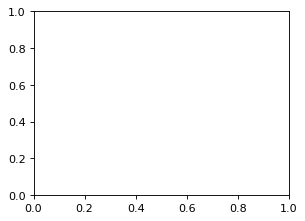

In [22]:
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
figure(num=None, figsize=(14, 14), dpi=80, facecolor='w', edgecolor='k')

zero = []
for j in range(10):
    zero = []
    for i in range(len(aMatrix)):
        zero.append(aMatrix[i][j][j])
    plt.subplot(4,3,j+1)
    plt.plot(np.arange(0,50,0.5),zero)
    plt.xlabel("Shade")
    plt.ylabel("Accuracy")
plt.suptitle("MR: Rotation")
plt.show()

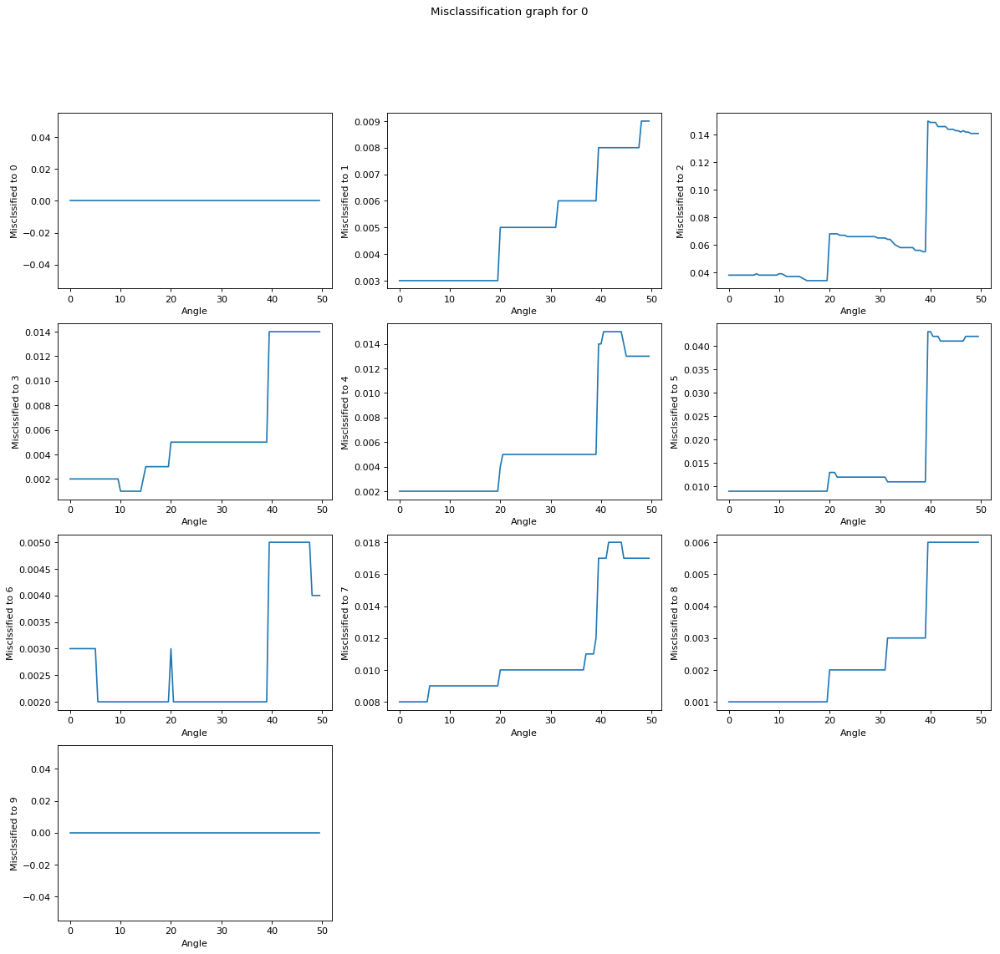

---------------------------------------------------------------------------------------------------------------------


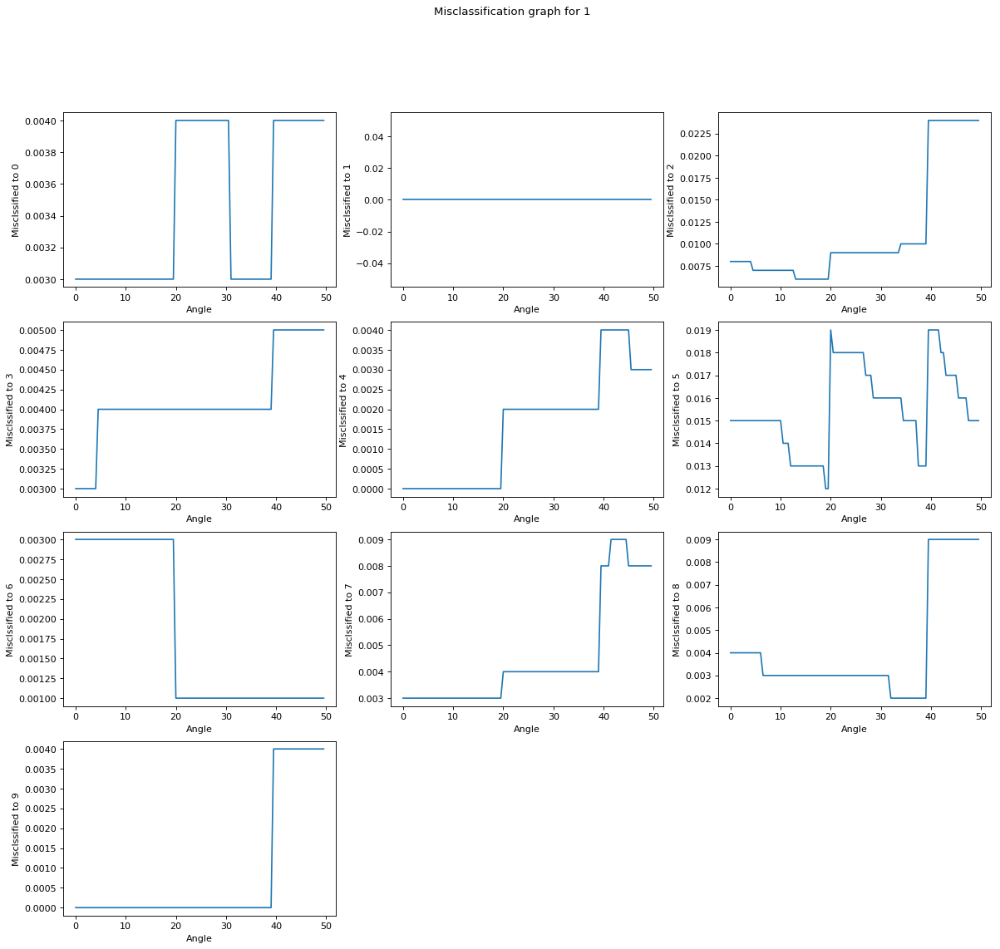

---------------------------------------------------------------------------------------------------------------------


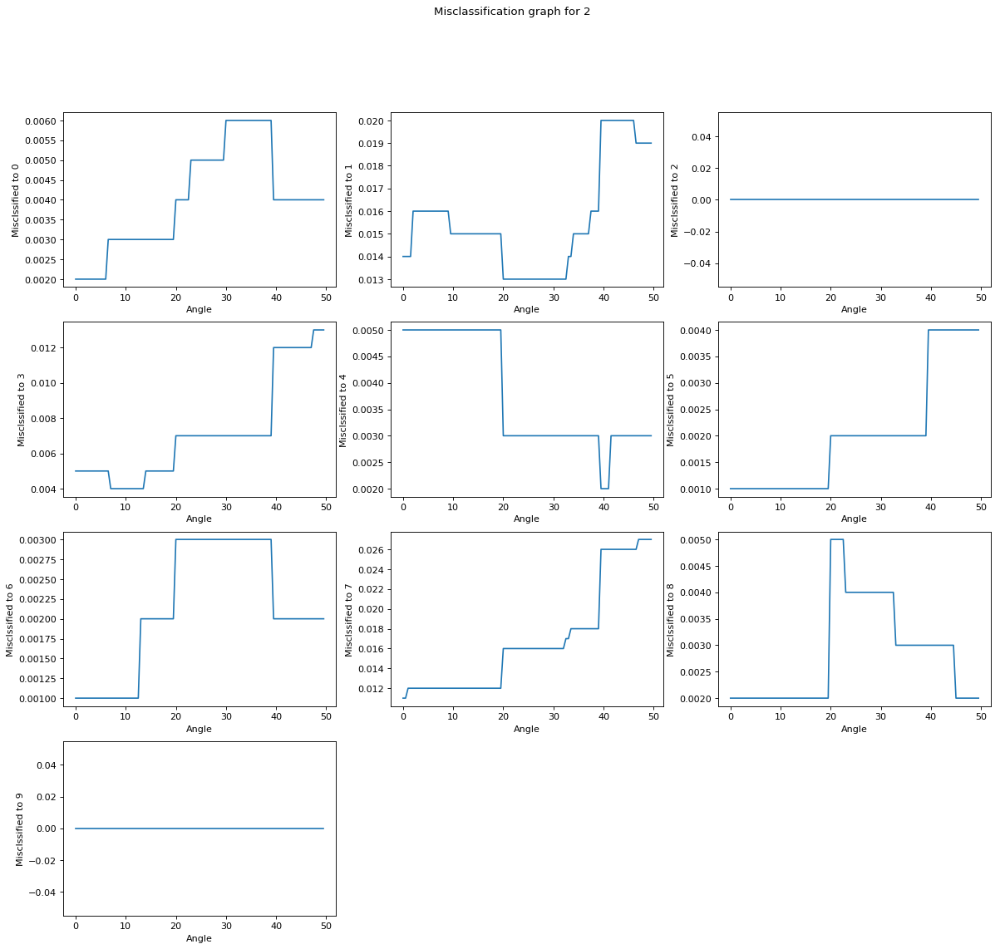

---------------------------------------------------------------------------------------------------------------------


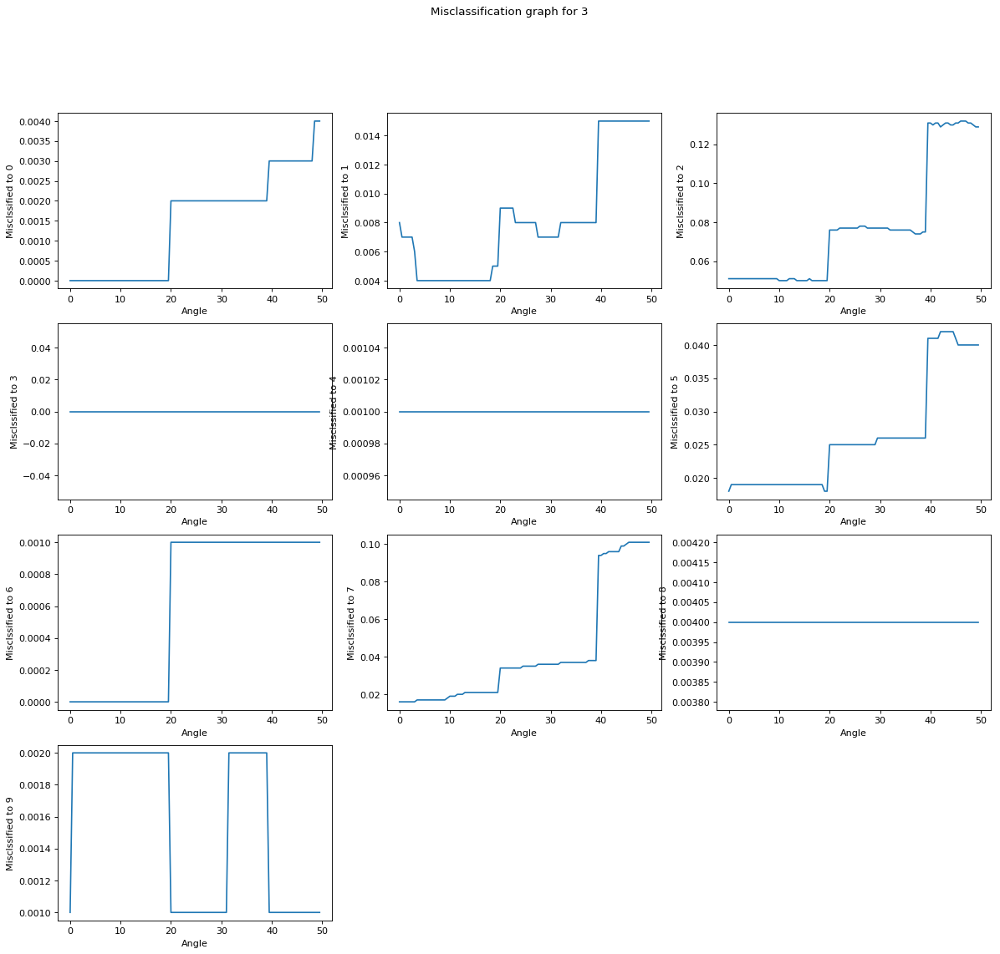

---------------------------------------------------------------------------------------------------------------------


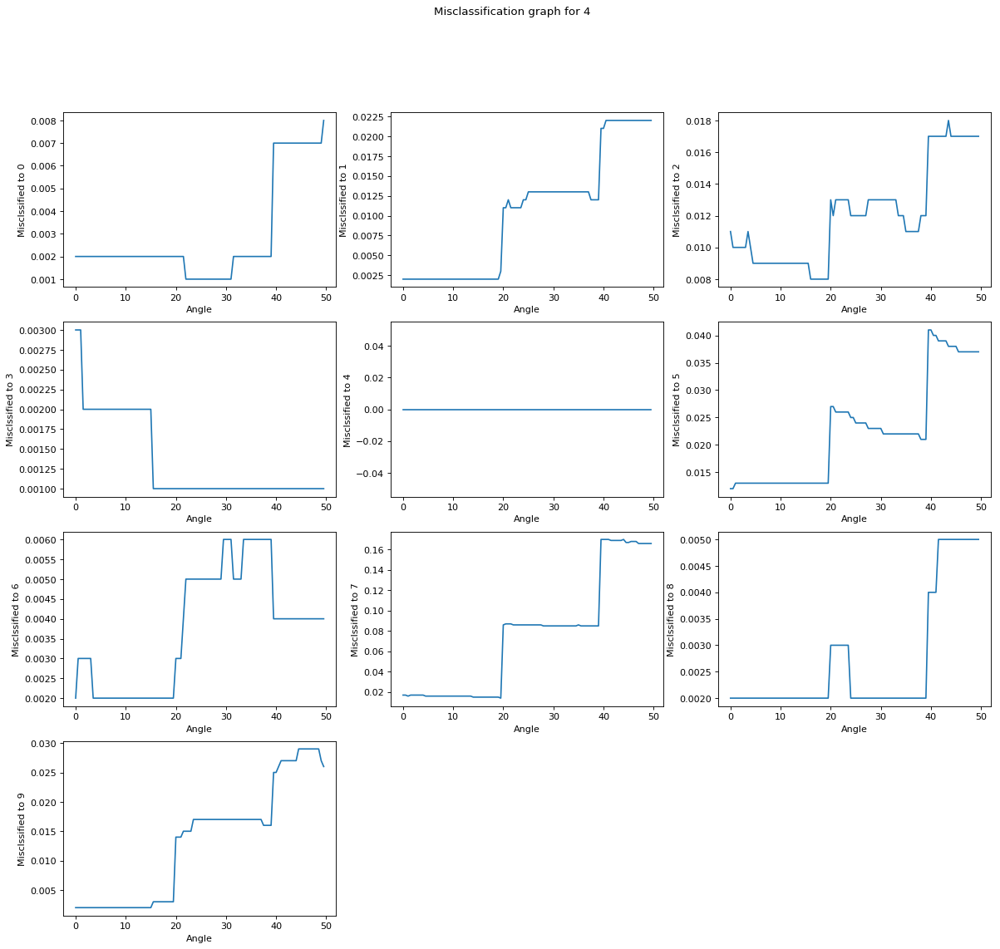

---------------------------------------------------------------------------------------------------------------------


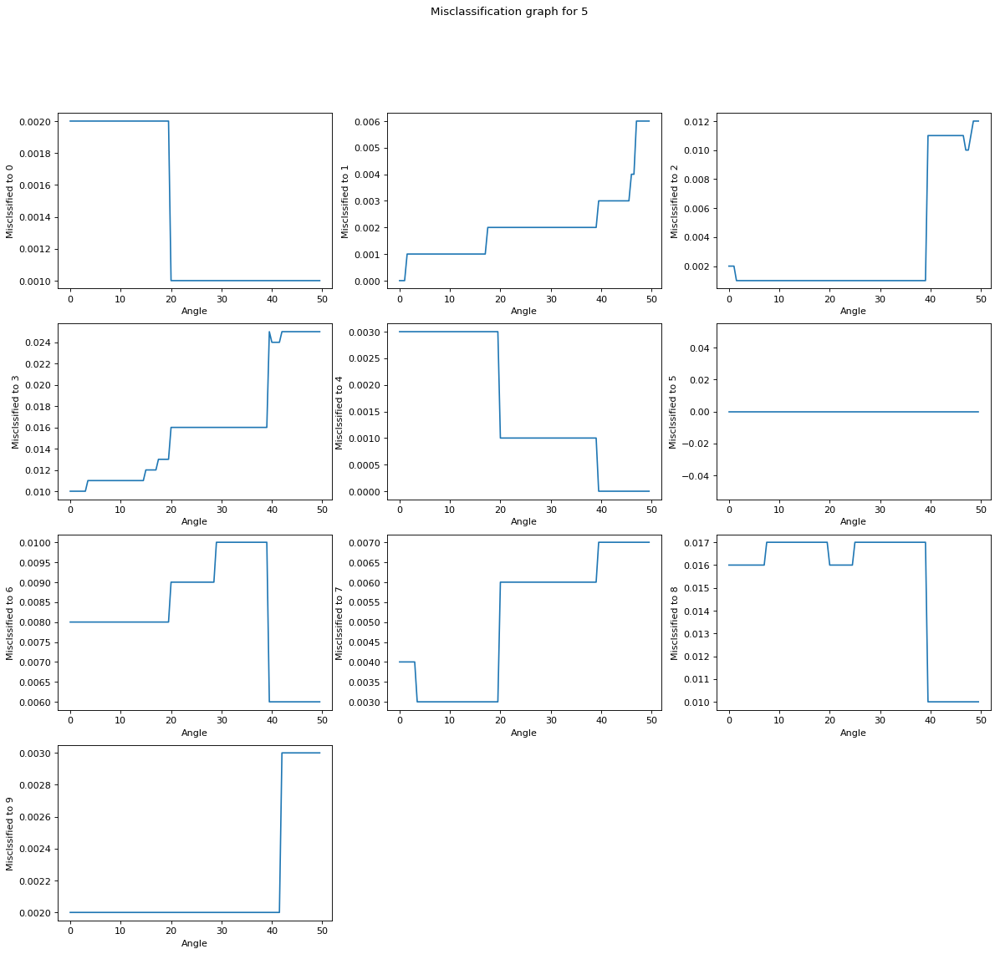

---------------------------------------------------------------------------------------------------------------------


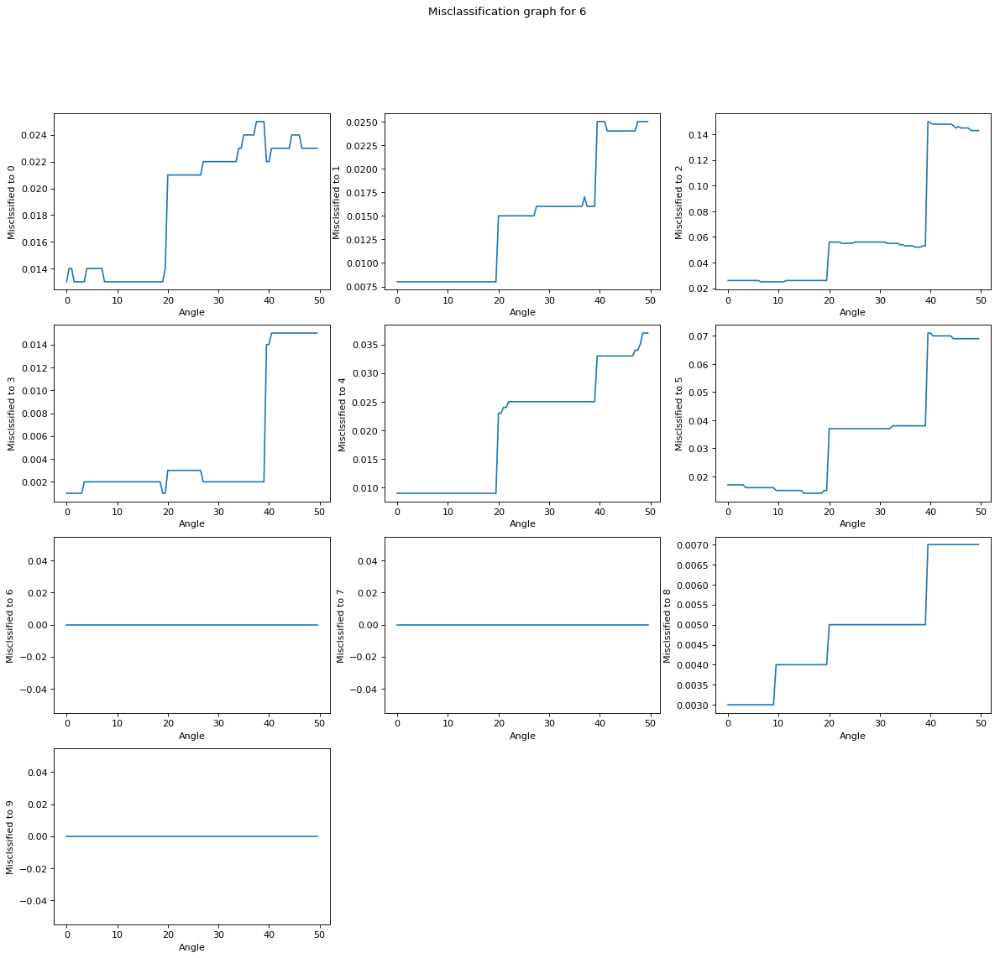

---------------------------------------------------------------------------------------------------------------------


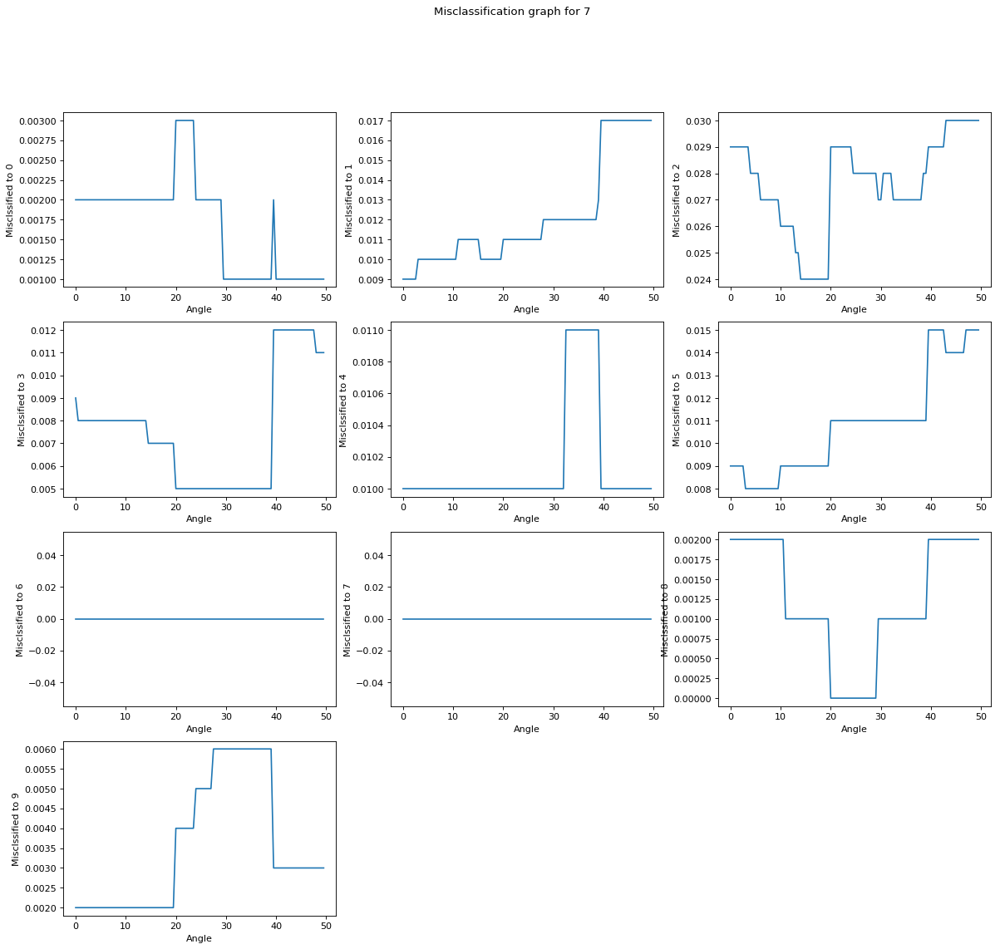

---------------------------------------------------------------------------------------------------------------------


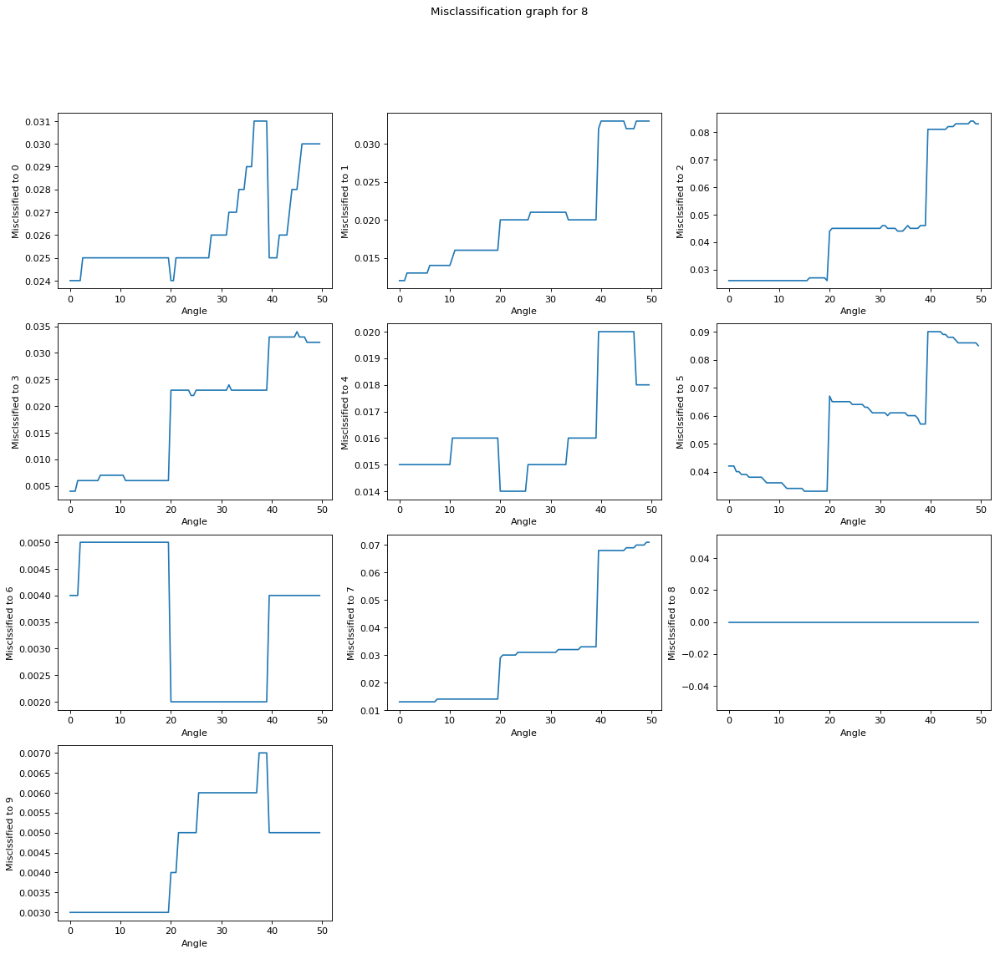

---------------------------------------------------------------------------------------------------------------------


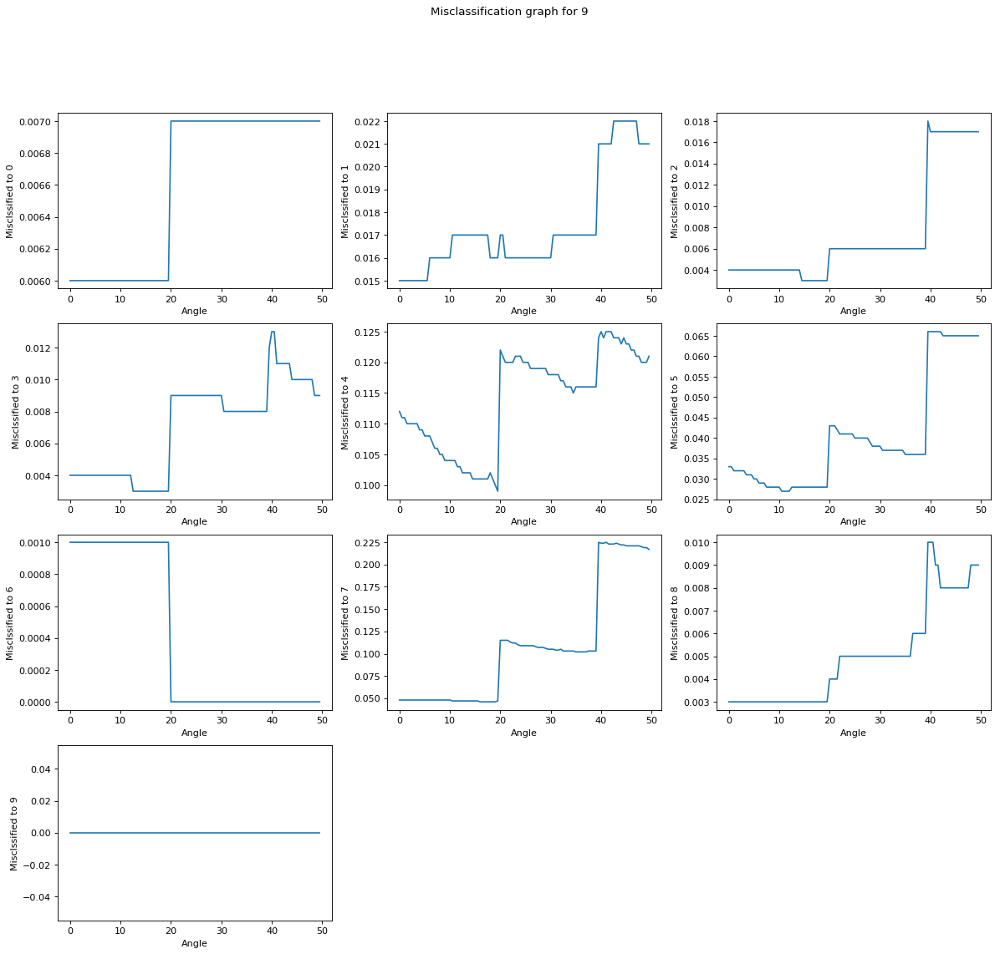

---------------------------------------------------------------------------------------------------------------------


In [13]:
zero = []

for j in range(10):
    figure(num=None, figsize=(18, 16), dpi=80, facecolor='w', edgecolor='k')
    for k in range(0,10):
        zero = []
        if j != k: 
            for i in range(len(aMatrix)):
                zero.append(aMatrix[i][j][k])
        else:
            zero+=100*[0]       
        plt.subplot(4,3,k+1)
        plt.plot(np.arange(0,50,0.5),zero)
        plt.xlabel("Angle")
        plt.ylabel("Misclssified to %s" %str(k))
    plt.suptitle("Misclassification graph for %d" %(j))
    plt.show()
    print("---------------------------------------------------------------------------------------------------------------------")